# Seam Carving + Twitter Cropping

This is a project exploring [the seam carving algorithm](http://www.faculty.idc.ac.il/arik/SCWeb/imret/imret.pdf) for cropping images. For a good explainer on seam carving, check out [Grant Sanderson's (3Brown1Blue) lecture](https://www.youtube.com/watch?v=rpB6zQNsbQU) explaining the topic. For more detail, I would also recommend [the original paper](http://www.faculty.idc.ac.il/arik/SCWeb/imret/imret.pdf) outlining the algorithm.

This notebook contains code to experiment using the seam carving algorithm, mainly focusing on a comparison of how seam carving might improve upon the algorithm used by Twitter for image preview.

The code used for seam carving was taken from [Karthik Karanth's post](https://karthikkaranth.me/blog/implementing-seam-carving-with-python/) for implementing the algorithm in python.

In [1]:
import sys, os, random, string

from tqdm import trange
import numpy as np
from imageio import imread, imwrite
from scipy.ndimage.filters import convolve
from numba import jit
from IPython.display import Image

### Original Implementation from Karthik Karanth

Main code pulled from [Karthik's blog post](https://karthikkaranth.me/blog/implementing-seam-carving-with-python/), with some minor edits:

1. Based on Karthik's suggestion (see end of post), added use of numba.jit for faster compilation
2. Added minimum `seam` output from `minimum_seam()`, to be used by new `draw_seam()` function

In [2]:
def calc_energy(img):
    filter_du = np.array([
        [1.0, 2.0, 1.0],
        [0.0, 0.0, 0.0],
        [-1.0, -2.0, -1.0],
    ])
    # This converts it from a 2D filter to a 3D filter, replicating the same
    # filter for each channel: R, G, B
    filter_du = np.stack([filter_du] * 3, axis=2)

    filter_dv = np.array([
        [1.0, 0.0, -1.0],
        [2.0, 0.0, -2.0],
        [1.0, 0.0, -1.0],
    ])
    # This converts it from a 2D filter to a 3D filter, replicating the same
    # filter for each channel: R, G, B
    filter_dv = np.stack([filter_dv] * 3, axis=2)

    img = img.astype('float32')
    convolved = np.absolute(convolve(img, filter_du)) + np.absolute(convolve(img, filter_dv))

    # We sum the energies in the red, green, and blue channels
    energy_map = convolved.sum(axis=2)

    return energy_map

@jit
def minimum_seam(img):
    r, c, _ = img.shape
    energy_map = calc_energy(img)

    M = energy_map.copy()
    backtrack = np.zeros_like(M, dtype=np.int)

    for i in range(1, r):
        for j in range(0, c):
            # Handle the left edge of the image, to ensure we don't index a -1
            if j == 0:
                idx = np.argmin(M[i - 1, j:j + 2])
                backtrack[i, j] = idx + j
                min_energy = M[i-1, idx + j]
            else:
                idx = np.argmin(M[i - 1, j - 1:j + 2])
                backtrack[i, j] = idx + j - 1
                min_energy = M[i - 1, idx + j - 1]

            M[i, j] += min_energy

    seam = np.zeros(r, dtype = np.int32)
    j = np.argmin(M[-1])
    for i in reversed(range(r)):
        seam[i] = j
        j = backtrack[i, j]

    return M, backtrack, seam

@jit
def carve_column(img):
    r, c, _ = img.shape

    M, backtrack, seam = minimum_seam(img)
    mask = np.ones((r, c), dtype = np.bool)

    for i in range(r):
        mask[i, seam[i]] = False

    mask = np.stack([mask] * 3, axis=2)
    img = img[mask].reshape((r, c - 1, 3))
    return img

def crop_c(img, scale_c):
    r, c, _ = img.shape
    new_c = int(scale_c * c)

    for i in trange(c - new_c):
        img = carve_column(img)

    return img

def crop_r(img, scale_r):
    img = np.rot90(img, 1, (0, 1))
    img = crop_c(img, scale_r)
    img = np.rot90(img, 3, (0, 1))
    return img

### Additional functions

1. Function to view imageio images (stored as numpy ndarray)
2. Given an image, draws the 1px seam to remove

In [3]:
# temporarily save img in order to view it
def imview(img, temp = True):
    out_file = "imgs/%s.JPG" % ''.join([random.choice(string.ascii_letters) for i in range(8)])
    imwrite(out_file, img)
    view = Image(filename = out_file)
    if temp:
        os.remove(out_file)
    return view

# calculate seam for image and edit seam pixels before returning
def draw_seam(img, color = [255, 0, 0]):    
    M, backtrack, seam = minimum_seam(img)
    img_copy = img.copy()
    for ix in range(len(seam)):
        img_copy[ix, seam[ix]] = color
    return img_copy

# combine crop_r and crop_c based on size
def crop(img, scale):
    img_copy = img.copy()
    img_copy = crop_c(img_copy, scale[0])
    img_copy = crop_r(img_copy, scale[1])
    return img_copy 

### Use seam carving once on test image

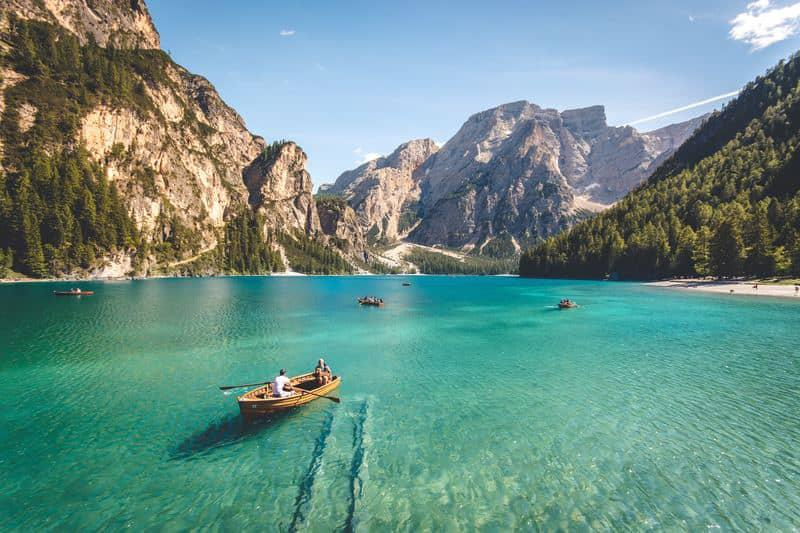

In [4]:
img = imread("imgs/landscape.JPG")
imview(img)

Lossy conversion from float32 to uint8. Range [0.0, 9612.0]. Convert image to uint8 prior to saving to suppress this warning.


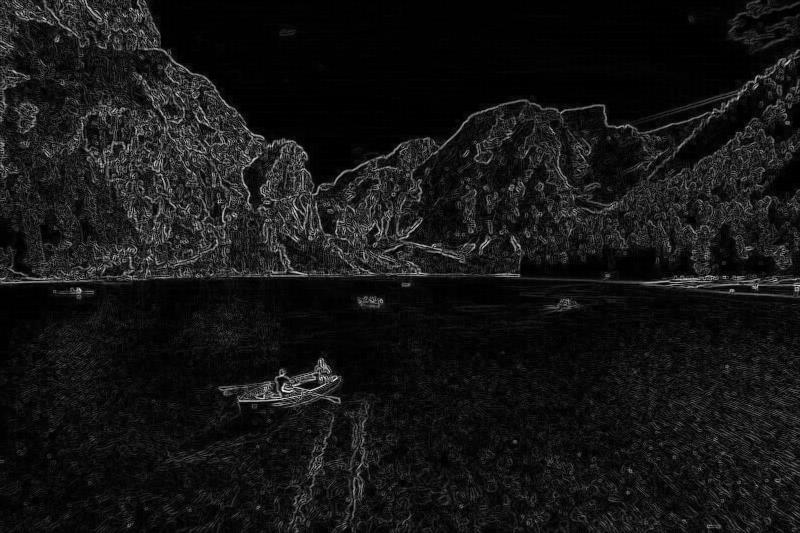

In [5]:
# view the edge detected image
imview(calc_energy(img))

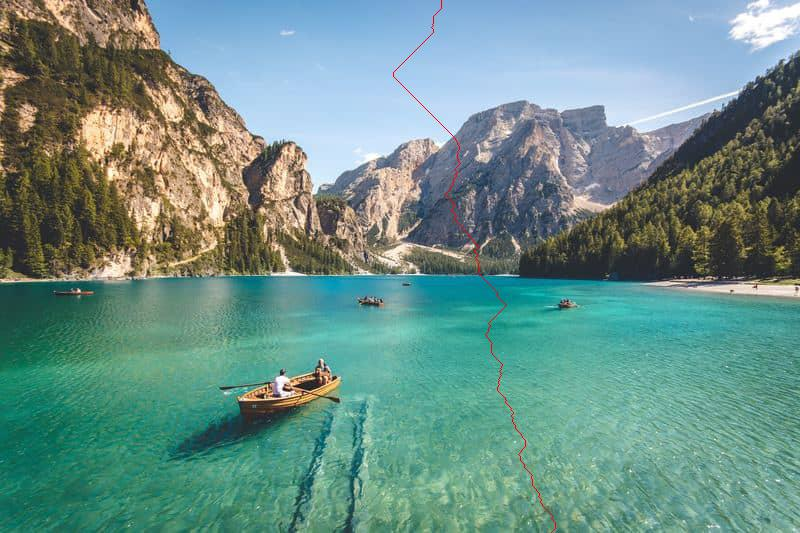

In [9]:
# view the image with the seam drawn
imview(draw_seam(img, [255, 0, 0]))

### Repeat seam carving process and create GIF

100%|██████████| 200/200 [01:48<00:00,  1.85it/s]


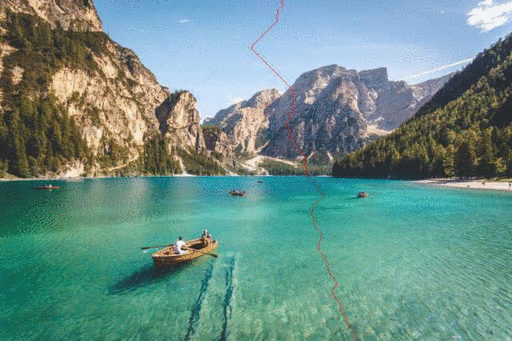

In [10]:
img_carved = img.copy()
r, c, _ = img.shape
extent_shape = "%dx%d" % (c, r)
c_new = int(c * 0.75)

# repeatedly carve out seam, saving stills along the way
# use imagemagick to add centering border to maintain consistent size of each still
for i in trange(c - c_new):
    img_file = "imgs/seam%04d.JPG" % i
    imwrite(img_file, draw_seam(img_carved))
    !magick convert $img_file -gravity center -extent $extent_shape \
        -background black -resize 80% -layers Optimize $img_file
    img_carved = carve_column(img_carved)
    
# use imagemagick to convert stills to gif then remove stills
!magick convert imgs/seam*.JPG -layers Optimize -resize 80% imgs/seam_animate.GIF
!rm imgs/seam*.JPG

# view gif
Image(filename = "imgs/seam_animate.GIF")

### Scale image down to Twitter preview size

Twitter images are 16/9

100%|██████████| 377/377 [00:16<00:00, 22.53it/s]
0it [00:00, ?it/s]


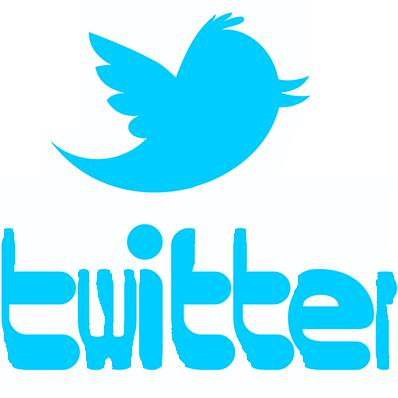

In [24]:
# load in twitter image
twitter_img_filename = "twitter-logo.JPG"
twitter_img = imread("imgs/" + twitter_img_filename)

# calculate new height or width
h, w, _ = twitter_img.shape
if (w / h) < 1:
    w_new = w
    h_new = w * 1
else:
    w_new = h * 1
    h_new = h
    
# crop image to 16/9 scaling, view, then save
twitter_img_carved = crop(twitter_img.copy(), (w_new / w, h_new / h))
imwrite("imgs/" + twitter_img_filename.replace(".", "-cropped."), twitter_img_carved)
imview(twitter_img_carved)

100%|██████████| 267/267 [00:19<00:00, 13.46it/s]
0it [00:00, ?it/s]


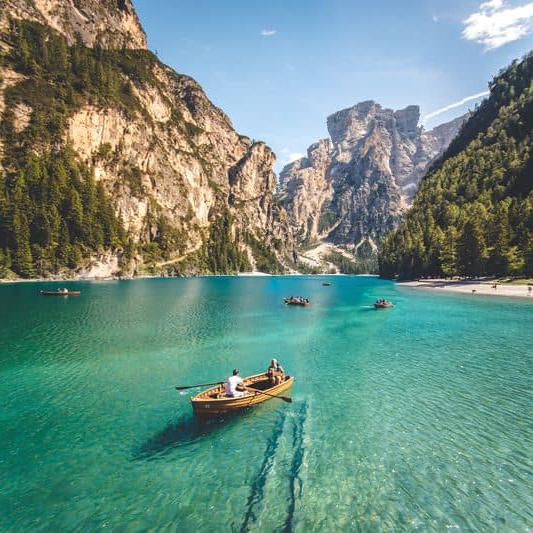

In [20]:
i = imread("imgs/landscape.JPG")
imview(crop(i, (533 / 800, 1)))

In [19]:
533 / 800

0.66625